In [1]:
from cell import Cell
from link_reader import LinkReader
import cells_extractor 
import visualizer
from cell_event import CellEvent, CellDefine, Cell

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import math
from matplotlib.colors import ListedColormap
from PIL import Image
import string
import cv2
import os
import matplotlib.patches as patches
import glob
from link_reader import LinkReader
import networkx as nx

In [3]:
from visualizer import CELL_EVENT_COLOR
from cell_event import CellEvent

In [4]:
mask = cells_extractor.get_omnipose_mask_dict("/Users/sherryyang/Documents/wiggins-lab/data/falimanted/masks/*.png")
cells, error = cells_extractor.get_cells_set_by_mask_dict(mask)

Frame:7, Mask label:1. Pixels number = 2. cannot make polygon. A linearring requires at least 4 coordinates.
Frame:11, Mask label:46. Pixels number = 1. cannot make polygon. A linearring requires at least 4 coordinates.
Frame:13, Mask label:1. Pixels number = 1. cannot make polygon. A linearring requires at least 4 coordinates.
Frame:22, Mask label:26. Pixels number = 2. cannot make polygon. A linearring requires at least 4 coordinates.


In [5]:
reader = LinkReader(cells)

In [7]:
spots_filename = "/Users/sherryyang/Documents/wiggins-lab/data/f/spots_filamented.csv"
edge_filename = "/Users/sherryyang/Documents/wiggins-lab/data/f/track_filamented.csv"
G_trackmate = reader.abstract_trackmate_linking_result(spots_filename, edge_filename, )

/Users/sherryyang/Projects/super-segger-toolkit/link_reader.py:160: UserWarning: Trackmate cell:3702 match back to mask is inaccute, assigned to the nearest cell.
  warnings.warn(f"Trackmate cell:{cell_id} match back to mask is inaccute, assigned to the nearest cell.")
/Users/sherryyang/Projects/super-segger-toolkit/link_reader.py:160: UserWarning: Trackmate cell:3705 match back to mask is inaccute, assigned to the nearest cell.
  warnings.warn(f"Trackmate cell:{cell_id} match back to mask is inaccute, assigned to the nearest cell.")
/Users/sherryyang/Projects/super-segger-toolkit/link_reader.py:160: UserWarning: Trackmate cell:3715 match back to mask is inaccute, assigned to the nearest cell.
  warnings.warn(f"Trackmate cell:{cell_id} match back to mask is inaccute, assigned to the nearest cell.")
/Users/sherryyang/Projects/super-segger-toolkit/link_reader.py:160: UserWarning: Trackmate cell:3712 match back to mask is inaccute, assigned to the nearest cell.
  warnings.warn(f"Trackmate

In [8]:
def quick_lieage(G):
    tag = visualizer.tag_type(G)
    pos = visualizer.get_lineage_pos(G)

    node_special = {CELL_EVENT_COLOR[CellEvent.BIRTH]: tag[CellEvent.BIRTH], CELL_EVENT_COLOR[CellEvent.DIE]: tag[CellEvent.DIE]}
    edge_special = {CELL_EVENT_COLOR[CellEvent.SPLIT]: tag[CellEvent.SPLIT], CELL_EVENT_COLOR[CellEvent.MERGE]: tag[CellEvent.MERGE]}

    visualizer.plot_lineage(G, pos, with_background = True , nodes_special = node_special, edges_special = edge_special)

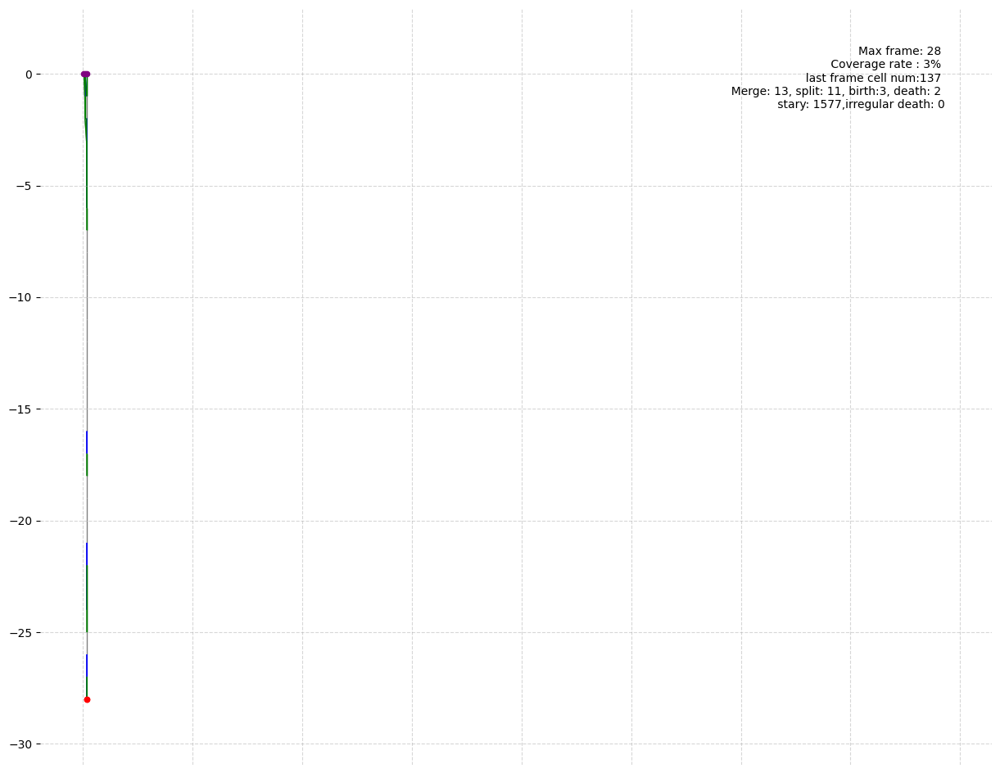

In [9]:
quick_lieage(G_trackmate)

In [10]:
read = LinkReader(cells)
G = read.make_new_dircted_graph()
dict = read.cells_frame_dict
sorted_frame = sorted(dict)

for i in range(1, len(sorted_frame)):
    source_frame = dict[sorted_frame[i-1]]
    target_frame =  dict[sorted_frame[i]]
    for cell in target_frame:
        max_IoU = 0
        best_candidate = None
        for cell_candicate in source_frame:
            intersect = cell.polygon.intersection(cell_candicate.polygon).area 
            union = cell.polygon.union(cell_candicate.polygon).area 
            IoU = intersect * 1.0 / union
            if IoU  > max_IoU:
                max_IoU  = IoU
                best_candidate = cell_candicate
        if best_candidate is not None:
            G.add_edge(best_candidate, cell)

    for cell in source_frame:
        if G.out_degree(cell) == 0:
            max_IoU = 0
            best_candidate = None
            for cell_candicate in target_frame:
                intersect = cell.polygon.intersection(cell_candicate.polygon).area 
                union = cell.polygon.union(cell_candicate.polygon).area 
                IoU = intersect * 1.0 / union
                if IoU  > max_IoU:
                    max_IoU  = IoU
                    best_candidate = cell_candicate
            if best_candidate is not None:
                G.add_edge(cell, best_candidate)

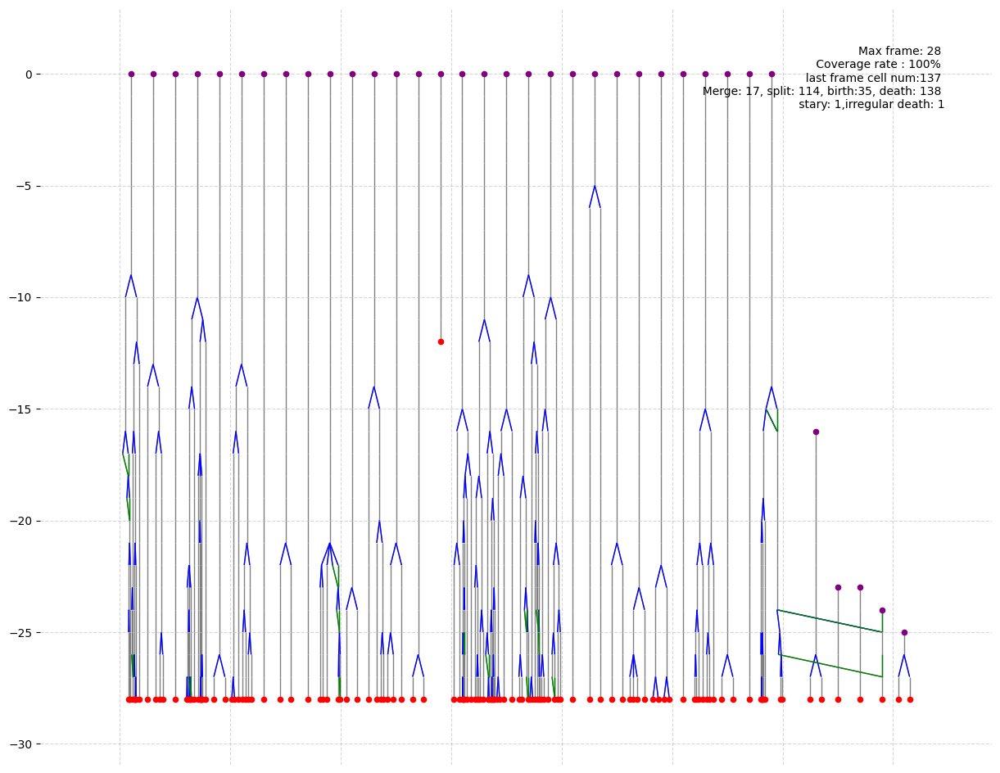

In [11]:
quick_lieage(G)

/Users/sherryyang/Projects/super-segger-toolkit/visualizer.py:319: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


TIF sequence created successfully.


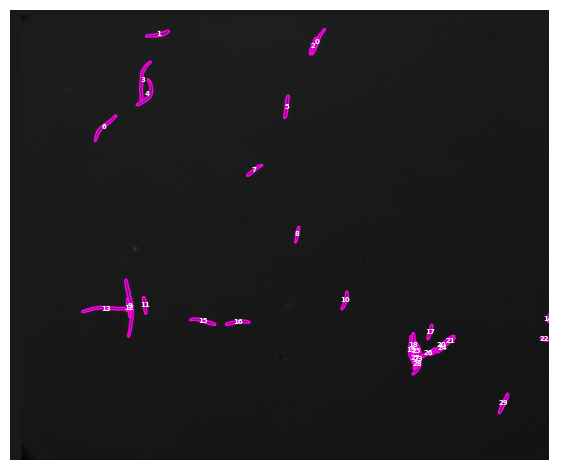

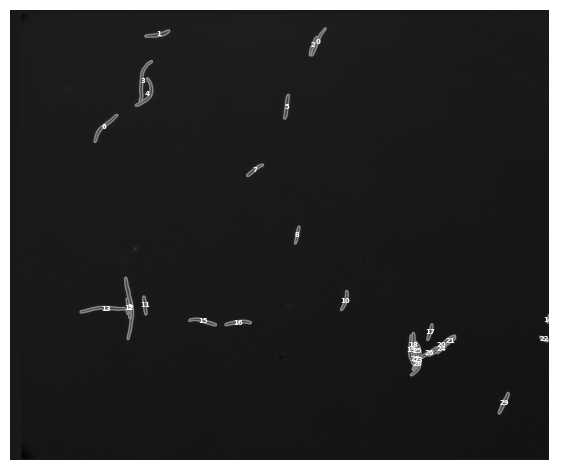

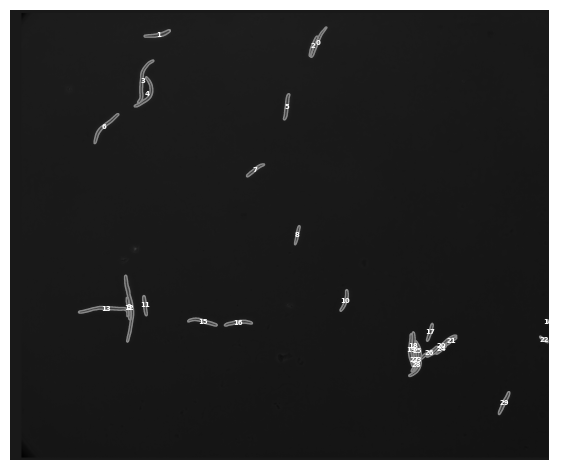

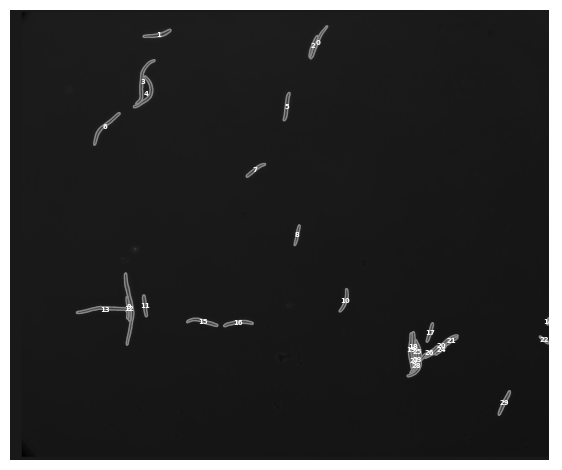

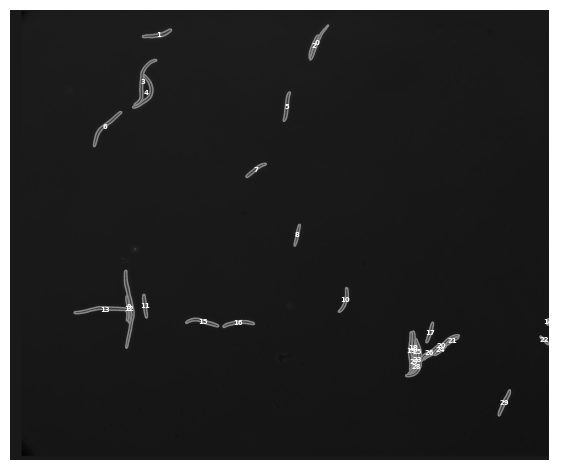

...

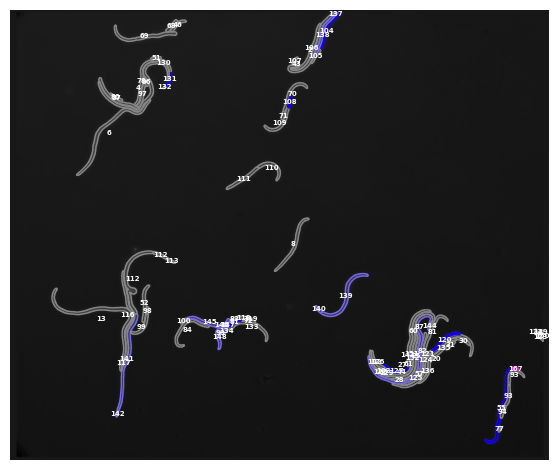

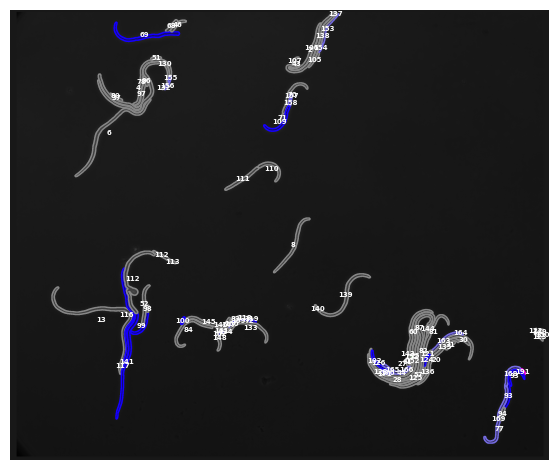

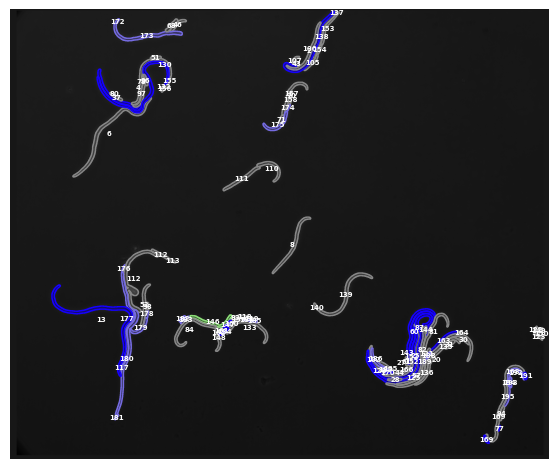

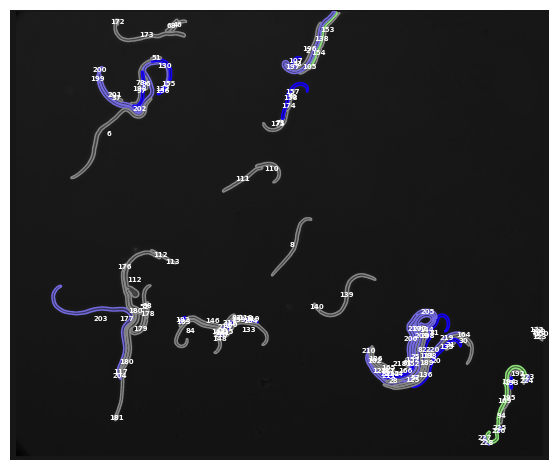

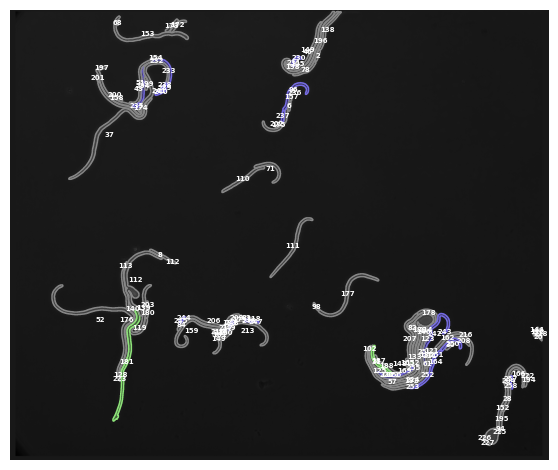

In [12]:
base_dir = "/Users/sherryyang/Documents/wiggins-lab/data/f/phase"
info = visualizer.get_label_info(G)
visualizer.get_single_track_visualization(G, base_dir,info)

In [18]:
visualizer.image_to_tif_sequence(base_dir + "/video")

TIF sequence created successfully.


In [21]:
visualizer.image_to_tif_sequence(base_dir + "/video")

TIF sequence created successfully.


/var/folders/tp/1bsthy355yj6qlmh5ym1996w0000gn/T/ipykernel_17458/3236851913.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(10, 12))  # Set the overall figure size


KeyError: 29

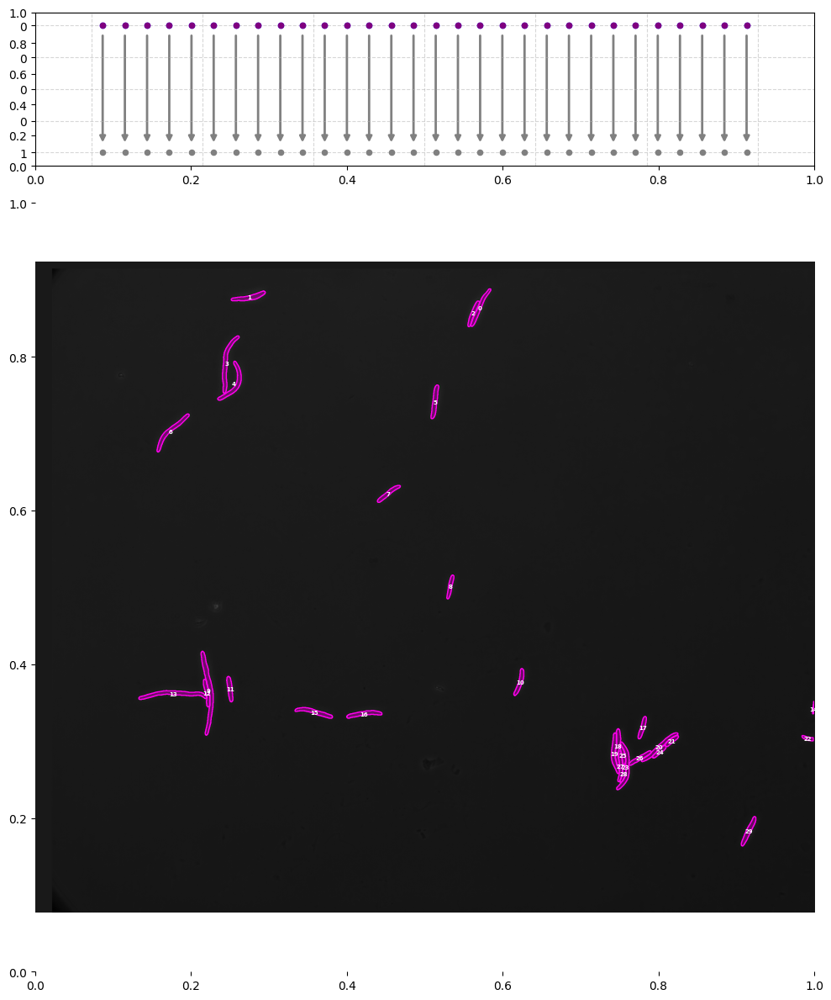

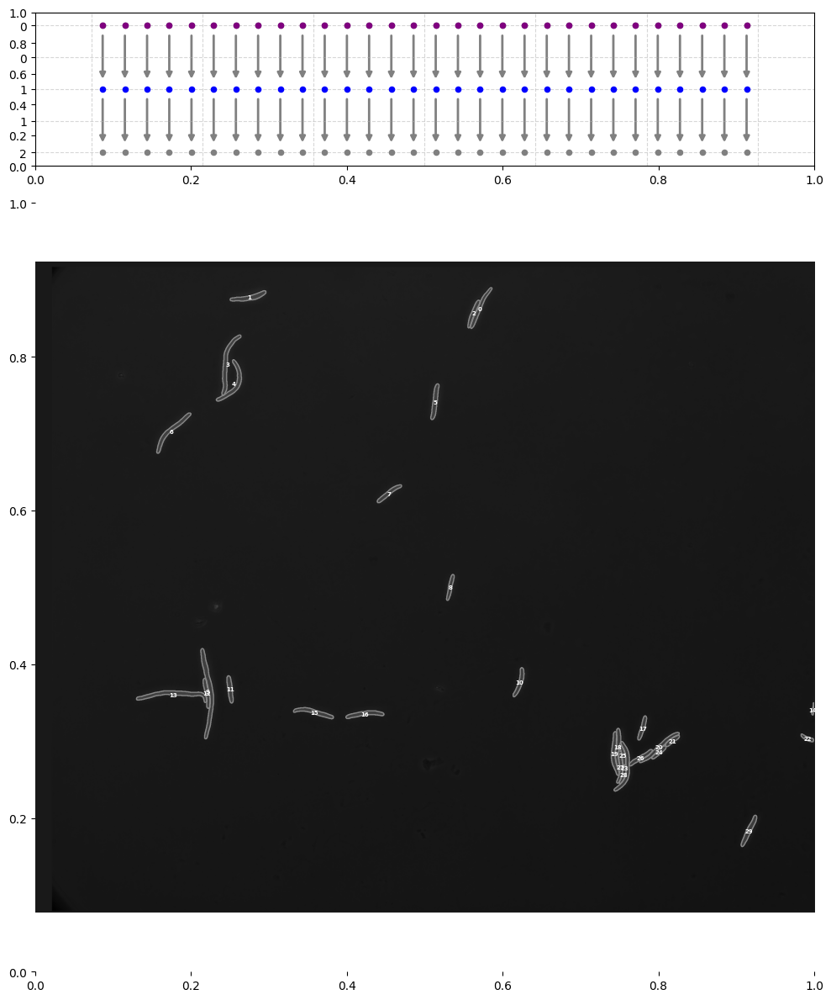

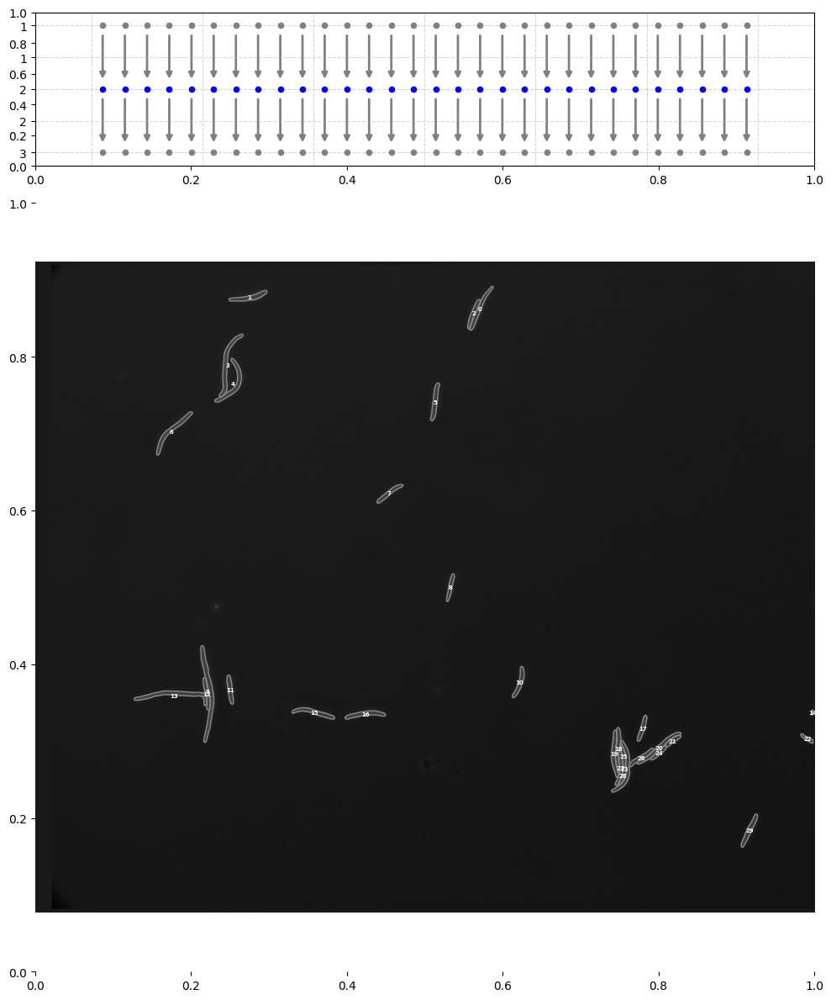

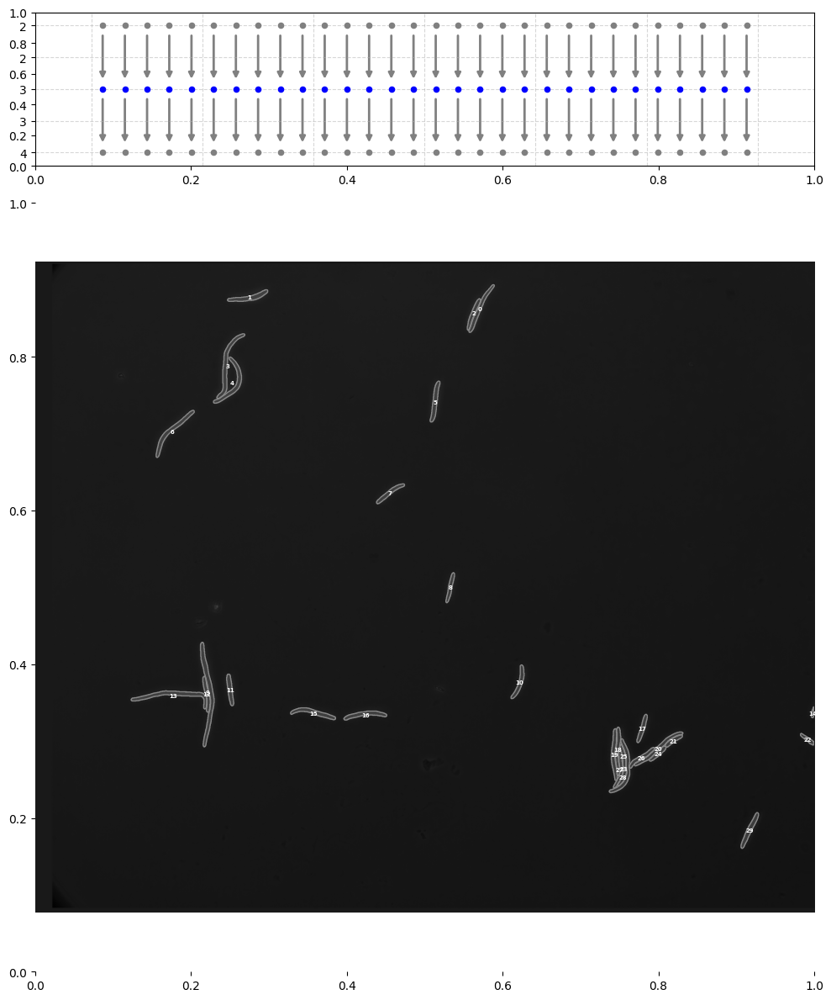

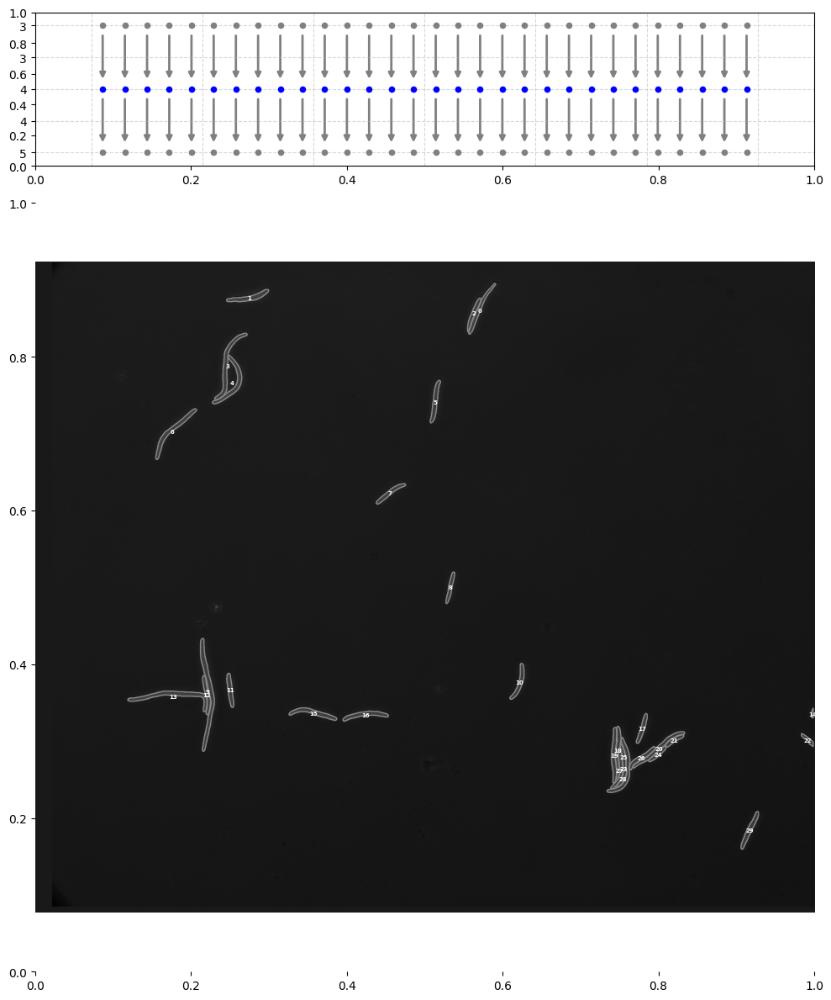

...

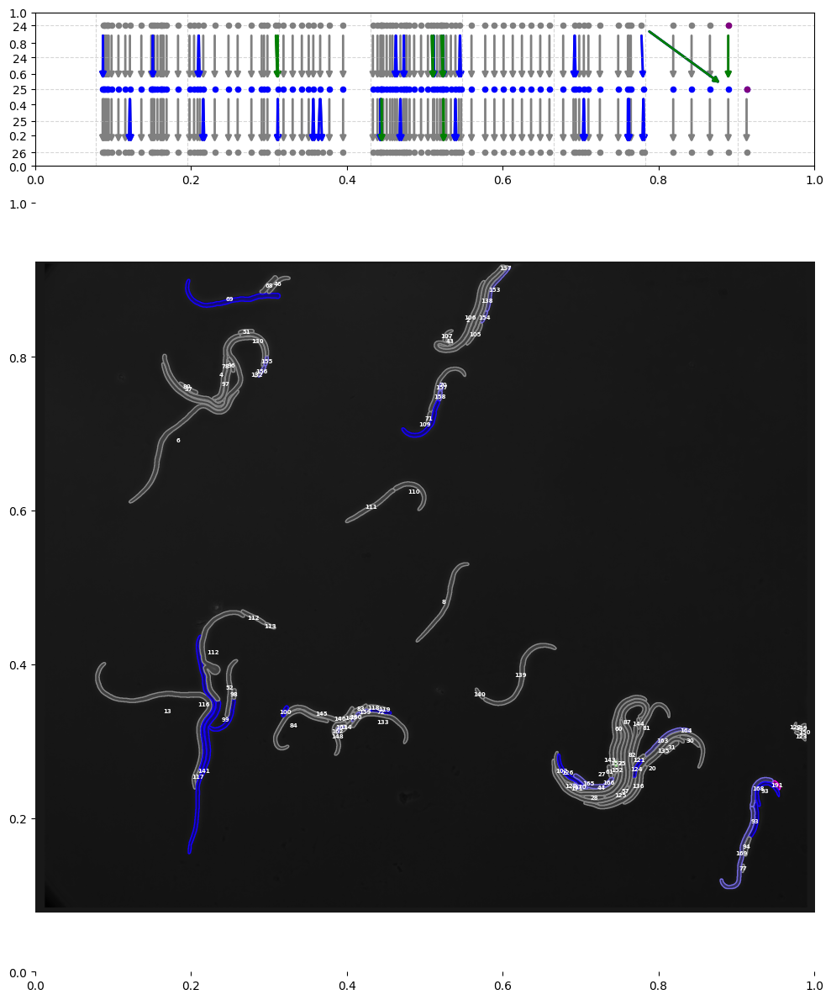

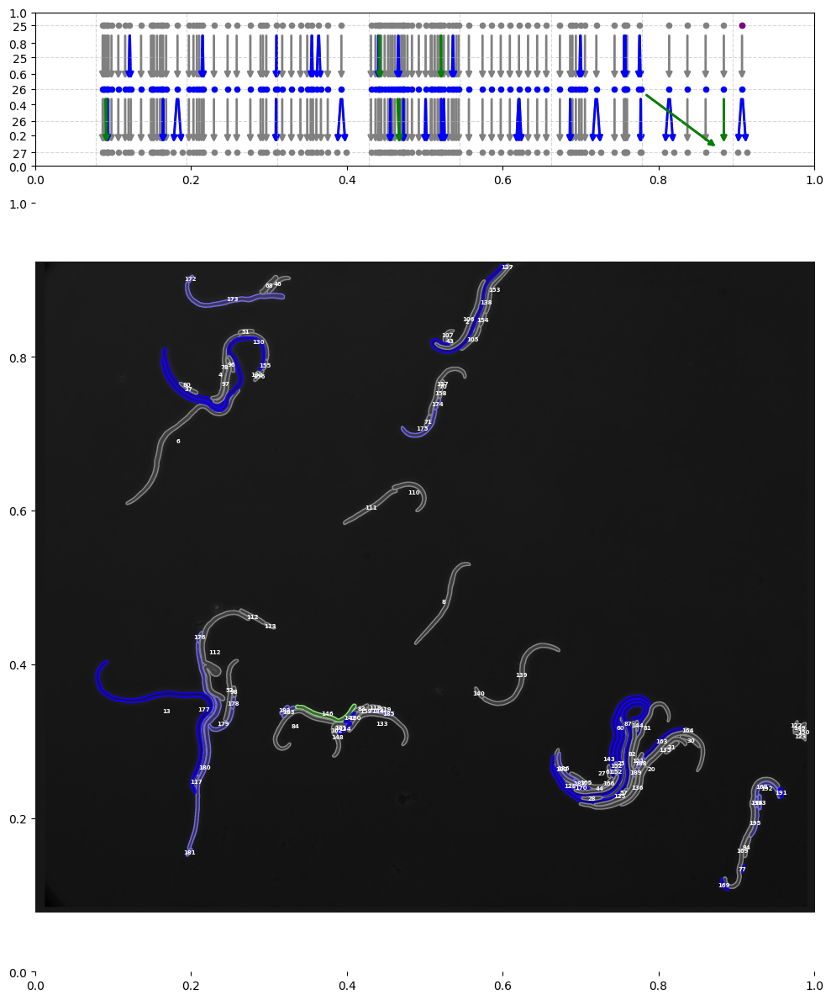

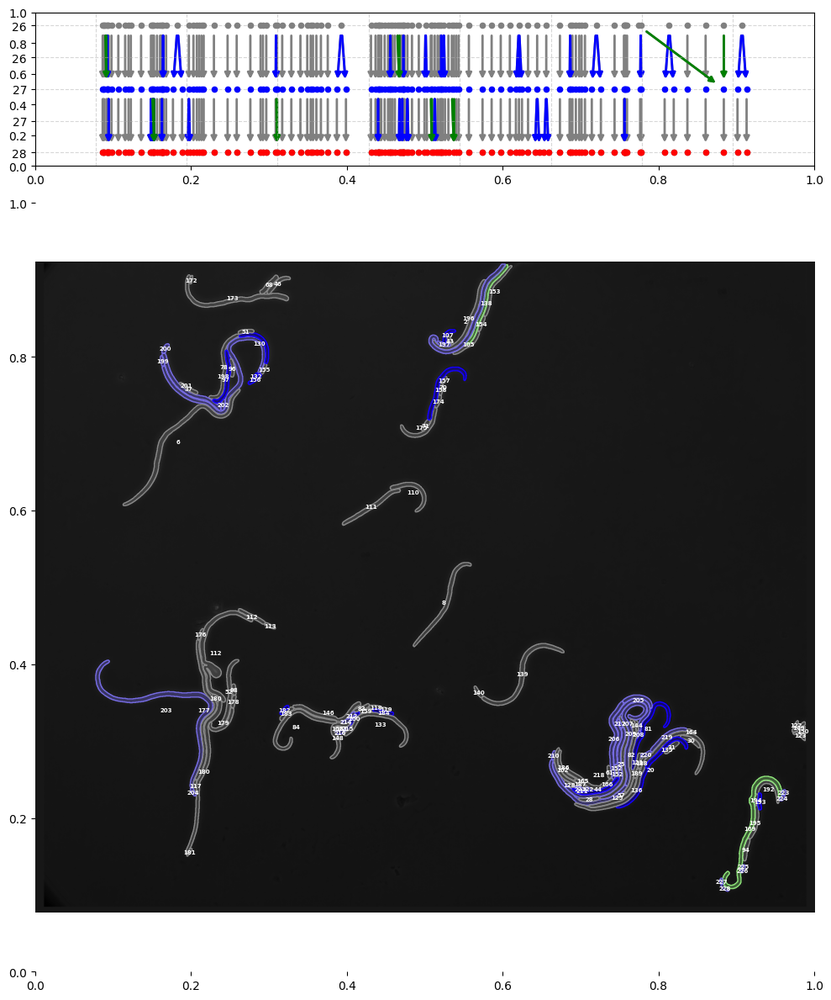

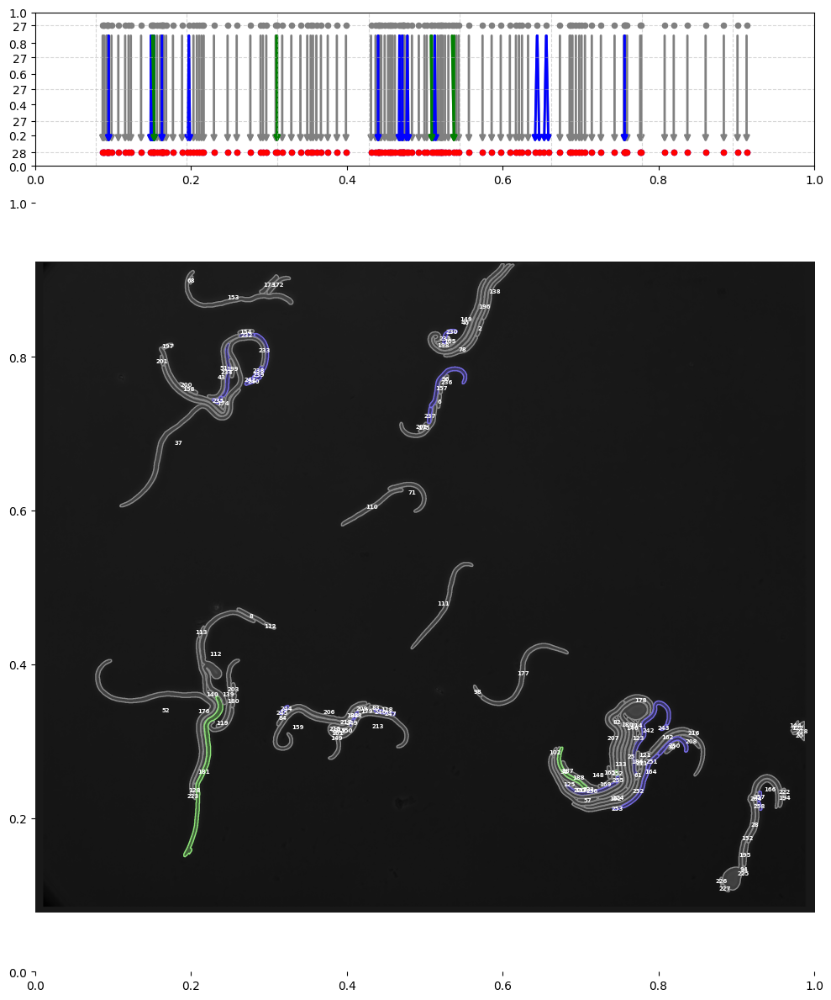

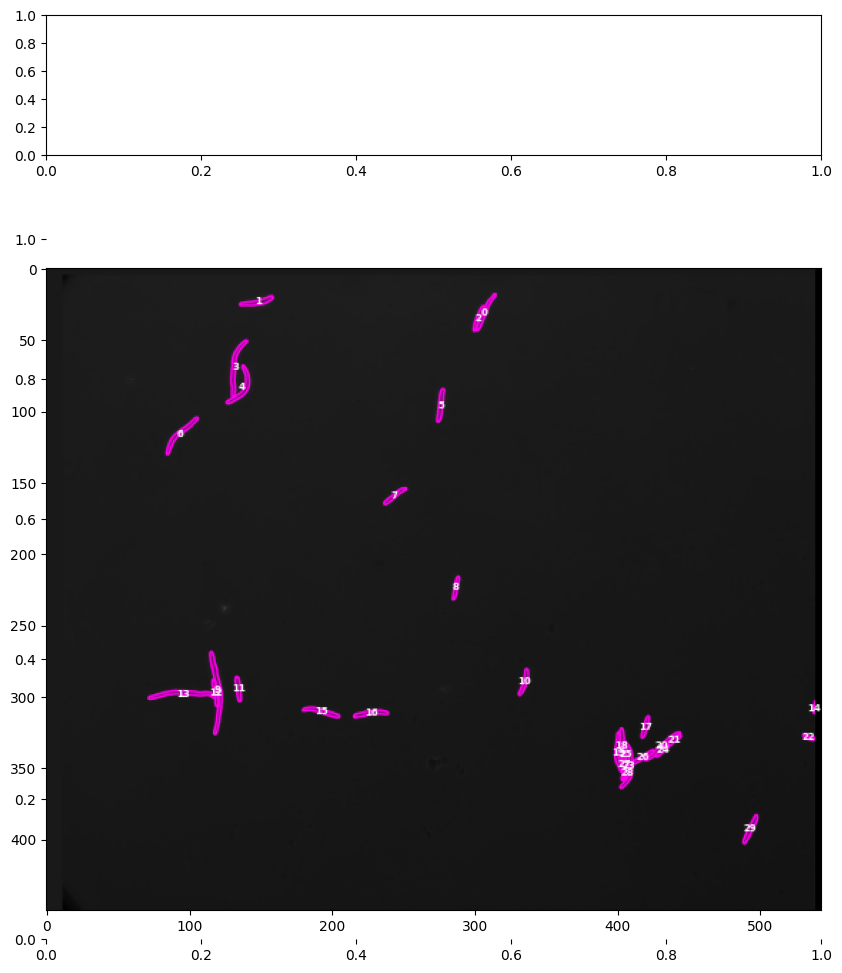

In [20]:
make_multi_visualization(G, base_dir, info)
visualizer.image_to_tif_sequence(base_dir + "/video")

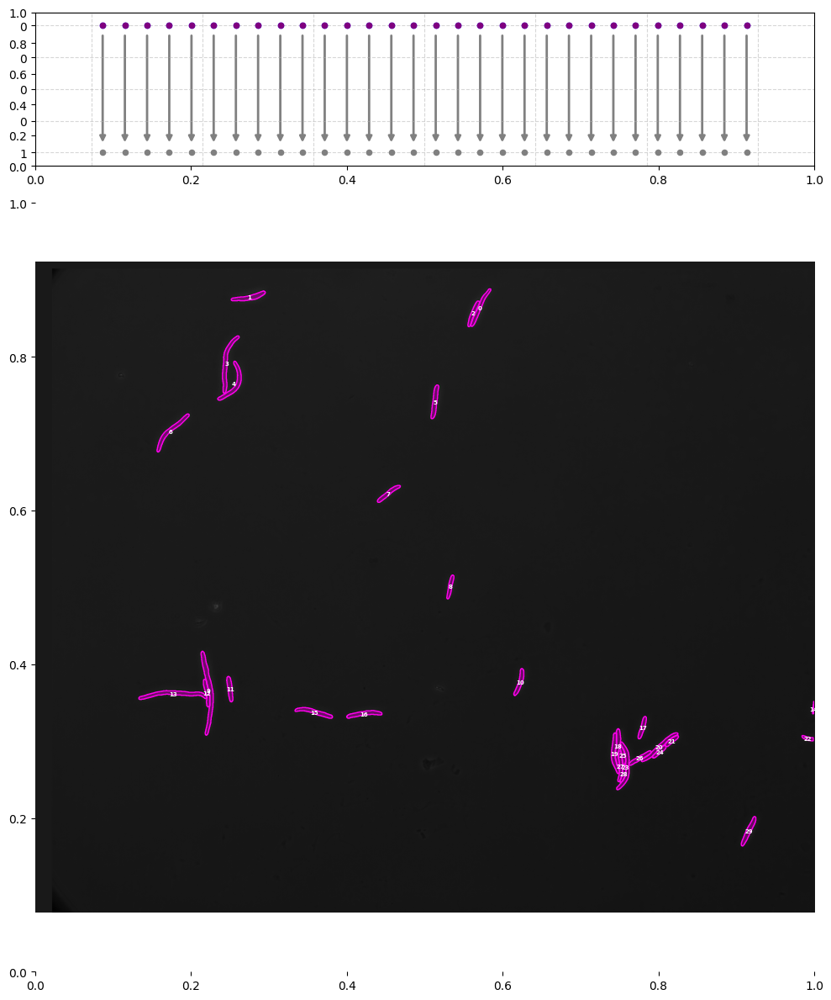

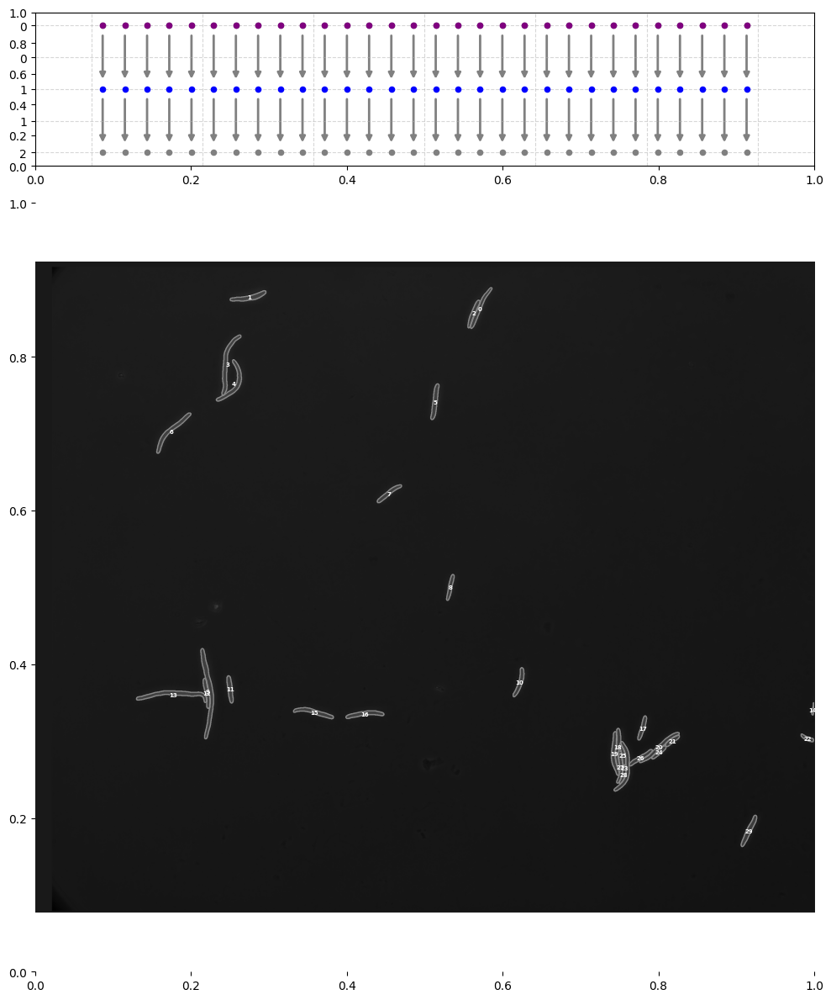

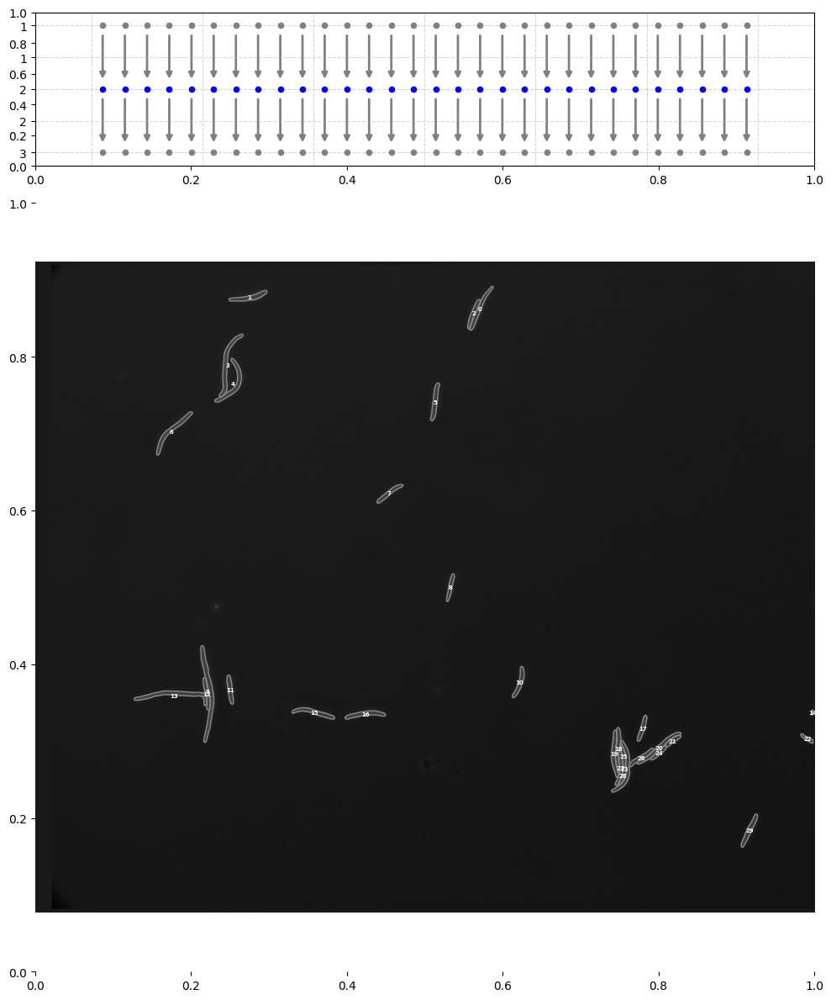

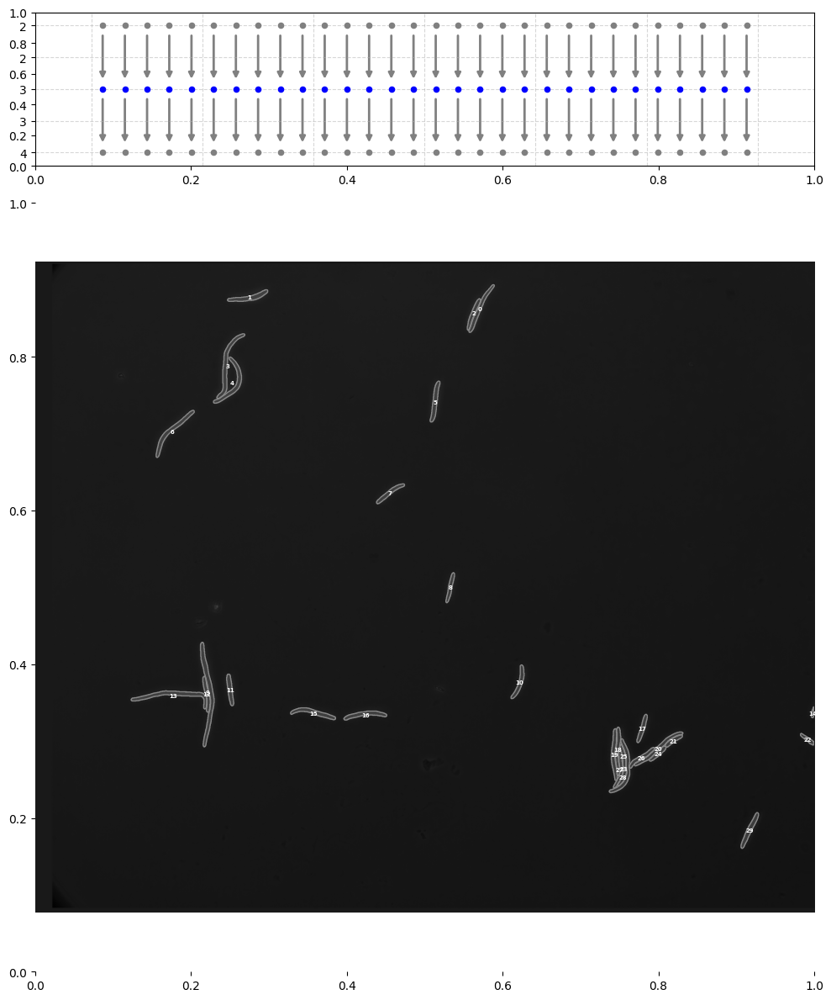

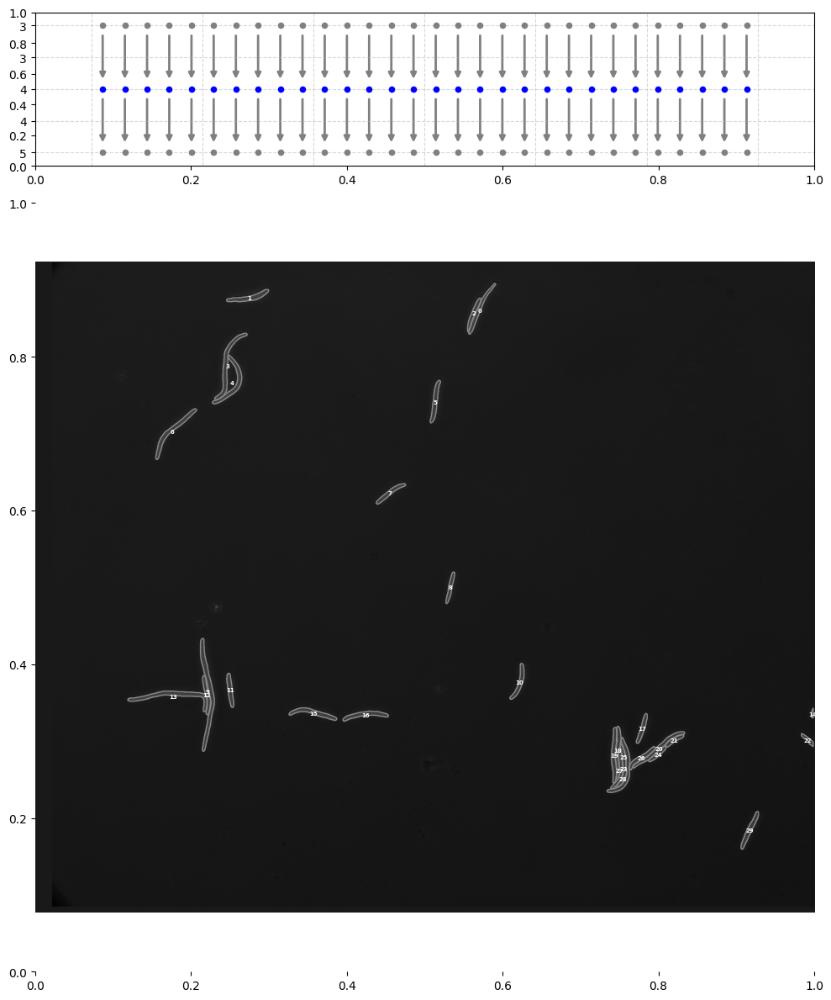

...

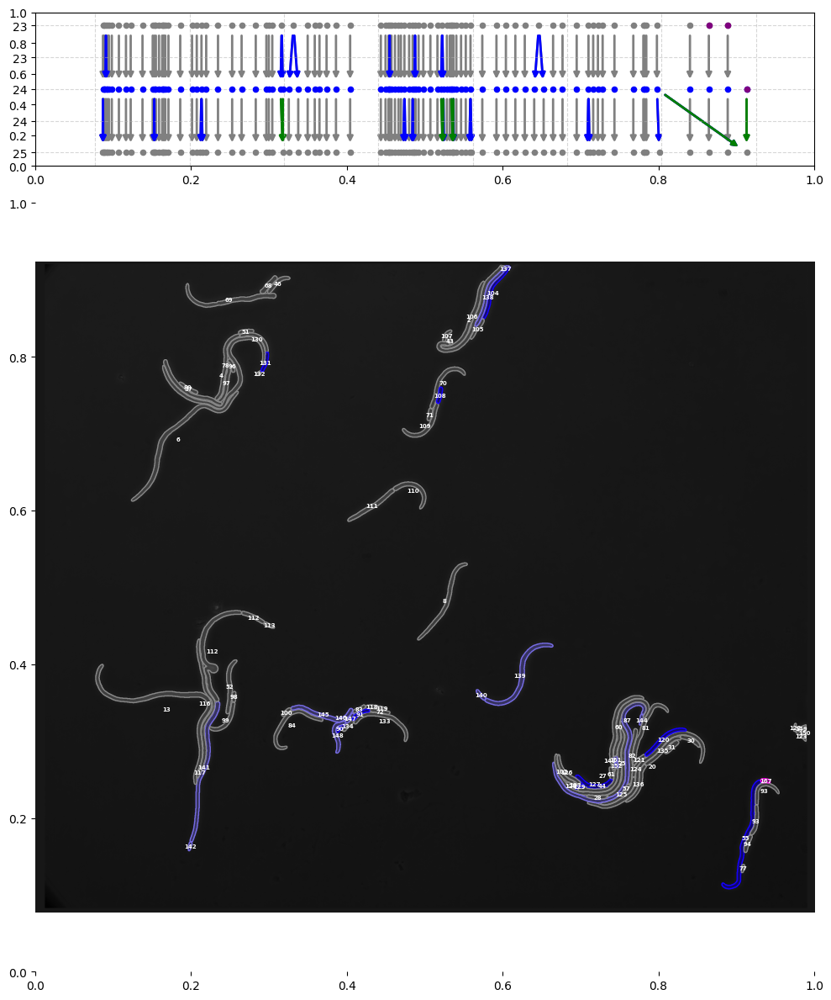

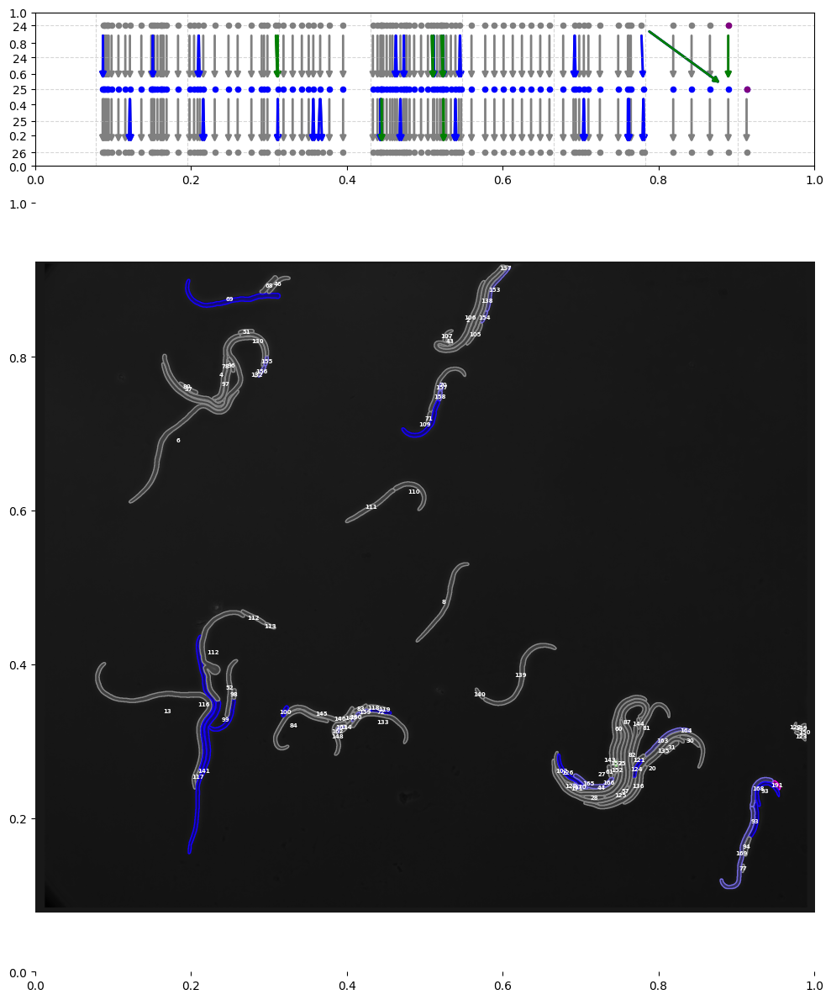

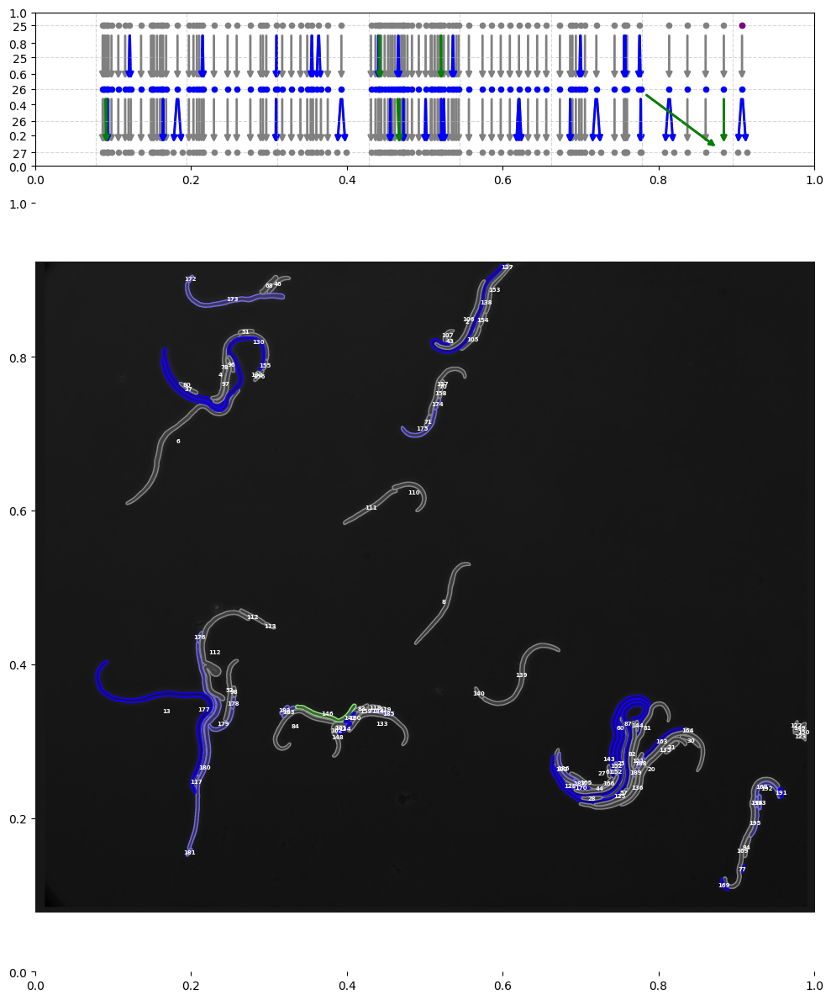

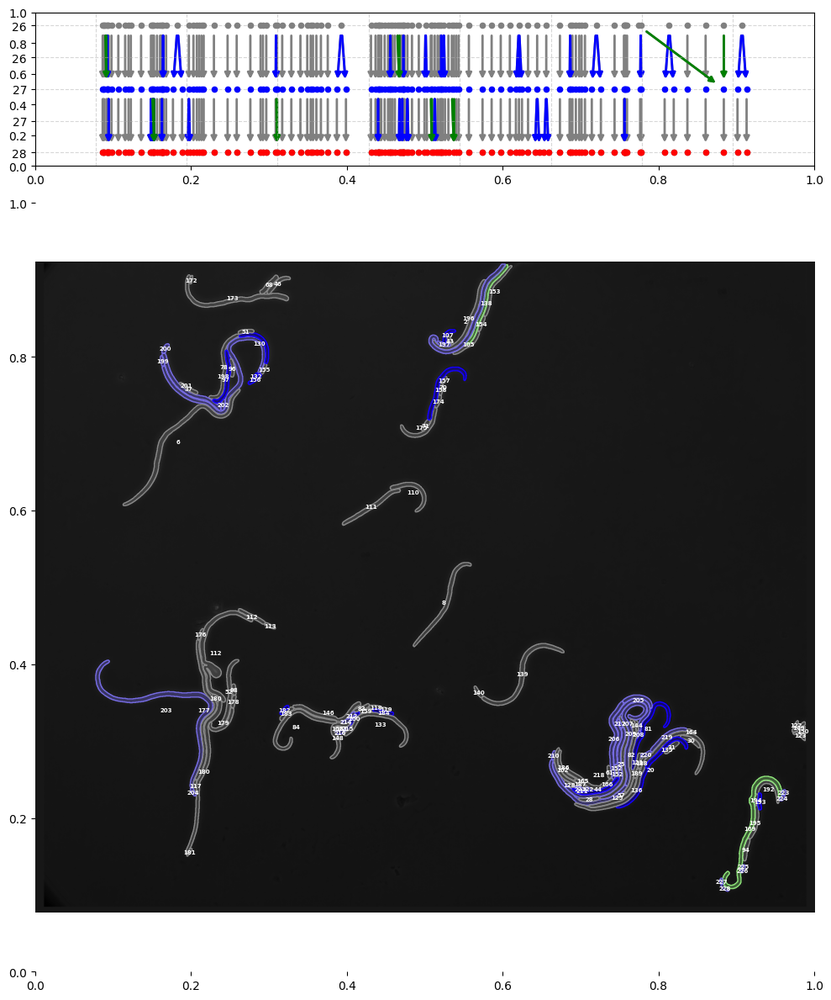

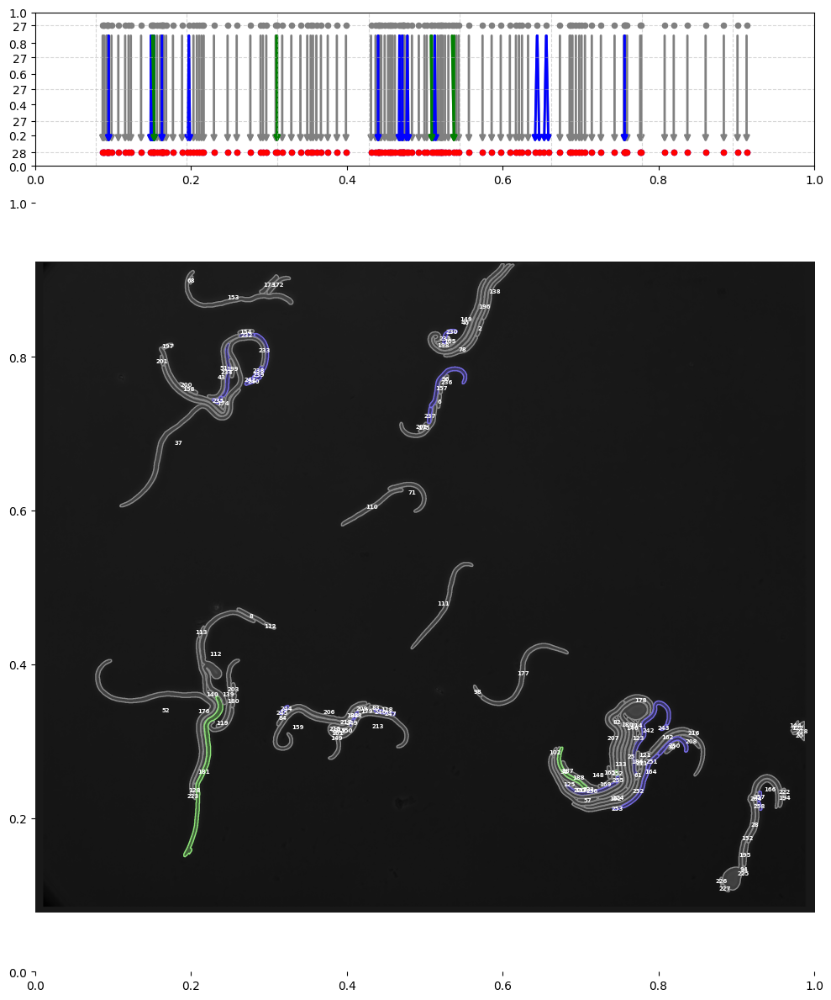

KeyError: 29

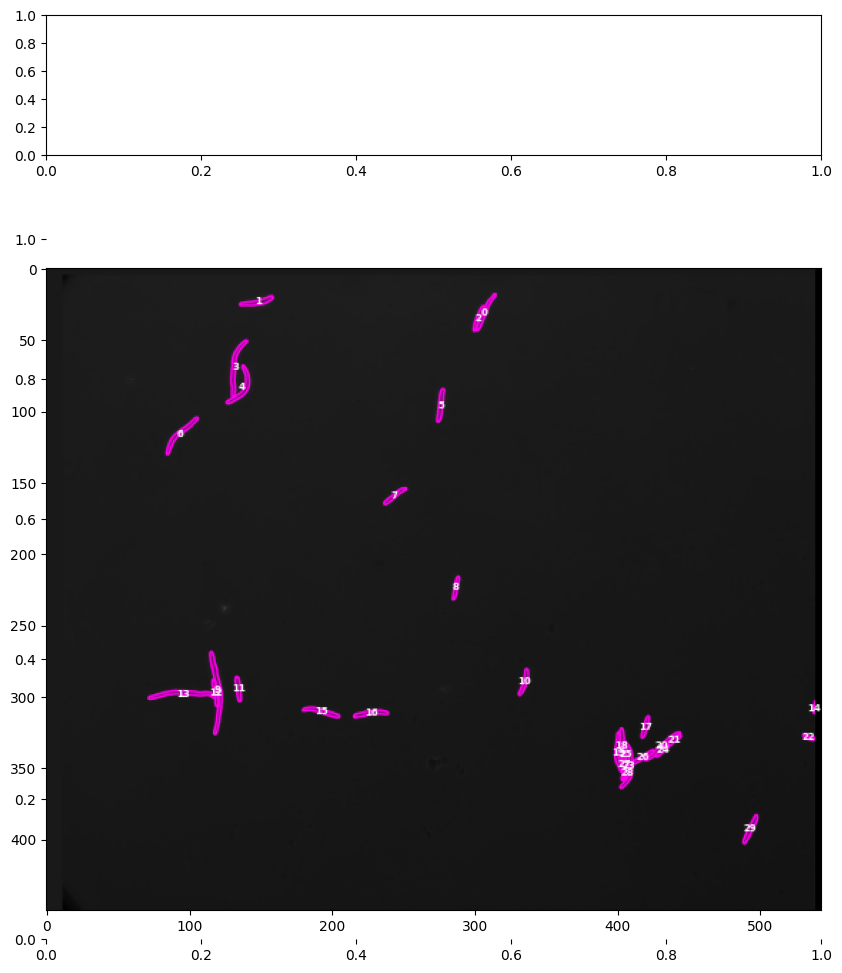

In [17]:
make_multi_visualization(G, base_dir, info)

In [19]:
import matplotlib.pyplot as plt
import cv2
import os
import glob
import matplotlib.gridspec as gridspec

def make_multi_visualization(G, base_dir, info, circle_label=False, representative_point=False):
    video_dir = os.path.join(base_dir, "video")
    os.makedirs(video_dir, exist_ok=True)

    reader = LinkReader(set(G.nodes()))

    filename = "*.tif"
    file_path = os.path.join(base_dir, filename)
    files = glob.glob(file_path)
    files.sort()

    tag = visualizer.tag_type(G)
    info = visualizer.get_label_info(G)
    pos = visualizer.get_lineage_pos(G)

    #for frame in range(len(files)):
    for frame in range(len(files)):
        file = files[frame]
        image = cv2.imread(file)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        output_path = os.path.join(video_dir, f"frame{frame:05d}.png")

    
        fig = plt.figure(figsize=(10, 12))  # Set the overall figure size

        # Define GridSpec
        gs = gridspec.GridSpec(2, 1, height_ratios=[1, 5]) 

        ax1 = fig.add_subplot(gs[0])
        ax2 = fig.add_subplot(gs[1])

        plt.box(on=None)
        
        # First subplot for the image
        ax1 = fig.add_subplot(2, 1, 2)  # Adjust layout as needed
        ax1.imshow(image)
        ax1 = visualizer.get_single_frame_visualization(ax1, image, reader.cells_frame_dict, info, frame, circle_label, representative_point)
        ax1.set_axis_off() 
        ax1.set_frame_on(False)
        ax1.axis('off')

        cell_s, edge_s, pos1 = visualizer.get_lineage_info_for_single_frame(G,frame,tag)
        # Second subplot for the lineage graph
        ax2 = fig.add_subplot(2, 1, 1)  # Adjust layout as needed
        ax2 = visualizer.sub_plot_lineage(ax2, G, pos, with_background=False, nodes_special=cell_s, edges_special=edge_s, arrow=True, show_stat=False)
        ax2.set_frame_on(False)

        plt.tight_layout()
        #plt.show()

        plt.savefig(output_path, bbox_inches='tight', pad_inches=0, transparent=True)
        # plt.close(fig)  # Close the figure after saving
